In [2]:
%pip install -r ../requirements.txt -q

Note: you may need to restart the kernel to use updated packages.


In [1]:
import os
import sys
import torch
import pandas as pd
from transformers import AutoTokenizer, AutoModel, utils, FlaxBertForTokenClassification, FlaxBertForMultipleChoice, BertForNextSentencePrediction
from bertviz import model_view, head_view
from transformers import pipeline
import jax
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
import plotly.graph_objects as graph_objects
import torch.nn.functional as F
import numpy as np

utils.logging.set_verbosity_error()

# os.environ["TOKENIZERS_PARALLELISM"] = "false"

In [2]:
MODEL_DISTILL = 'distilbert-base-uncased'
MODEL_BERT_BASE = 'bert-base-uncased'
MODEL_BERT_LARGE = 'bert-large-uncased'

In [21]:
DATA_DIR = '../data'
SPECIFIC_ABSTRACT_CSV = f'{DATA_DIR}/semantic.csv'
SEMANTIC = f'{DATA_DIR}/semantic.csv'
SEMANTIC_DATA = pd.read_csv(SEMANTIC)
SPECIFIC_ABSTRACT_DATA = pd.read_csv(SPECIFIC_ABSTRACT_CSV)

SPECIFIC_ABSTRACT_DATA

def prepare_multiple_choice_task():
    sd = SEMANTIC_DATA[:]
    sd = sd[sd['abs_choice'].notna()]
    sd = sd[sd['spec_choice'].notna()]
    return sd


In [24]:
prepare_questioner().head(12)

,word,specific,abstract,abs_choice,spec_choice,arb_choice1,arb_choice2
9,sharp,The knife is sharp. What does sharp mean?,She has a sharp mind.,intelligent,cutting edge,She is not intelligent,The knife has a dull edge
10,light,He turned on the light.What does light mean?,You are the light of my life. What does light ...,joy,illumination,source of sadness,turned off the source of illumination
11,key,He turned the key in the lock. What is the mea...,Education is the key to success. What is the m...,Means to success,Lock device,Education is the barrier to success,He removed the device from operating the lock
12,cold,He gave me a cold water. What is the meaning o...,He gave me a cold stare. What is the meaning o...,unfriendly look,low temprature,He looked at me warmly,The weather is high in temperature
13,hard,The surface is hard.,He is a hard worker.,diligent worker,solid,He is a lazy worker,The surface is soft
14,deep,The pool is deep.,He is a deep thinker.,profound thinker,large depth,shallow thinker,small depth
15,bright,The room is bright. What is the meaning of bri...,She has a bright future. What is the meaning o...,hopeful,well lit,bleak future,dim
16,heavy,The box is heavy.,His heart was heavy with sorrow.,deeply saddened,great weight,He was extremely joyful,The box is of light weight
17,clean,The room is clean.,He has a clean record.,unblemished record,free from dirt,He has a tarnished record,The room is dirty
18,rich,He is rich.,The soil is rich.,fertile,wealthy,infertile,He is poor


In [5]:
pd.DataFrame(SEMANTIC_DATA_QUESTIONER)

,options,abstract,specific,abstract_meaning,specific_meaning
0,"[cutting edge, intelligent]",She has a sharp mind.,The knife is sharp. What does sharp mean?,intelligent,cutting edge
1,"[illumination, joy]",You are the light of my life. What does light ...,He turned on the light.What does light mean?,joy,illumination
2,"[Lock device, Means to success]",Education is the key to success. What is the m...,He turned the key in the lock. What is the mea...,Means to success,Lock device
3,"[low temprature, unfriendly look]",He gave me a cold stare. What is the meaning o...,He gave me a cold water. What is the meaning o...,unfriendly look,low temprature
4,"[solid, diligent worker]",He is a hard worker.,The surface is hard.,diligent worker,solid
5,"[large depth, profound thinker]",He is a deep thinker.,The pool is deep.,profound thinker,large depth
6,"[well lit, hopeful]",She has a bright future. What is the meaning o...,The room is bright. What is the meaning of bri...,hopeful,well lit
7,"[great weight, deeply saddened]",His heart was heavy with sorrow.,The box is heavy.,deeply saddened,great weight
8,"[free from dirt, unblemished record]",He has a clean record.,The room is clean.,unblemished record,free from dirt
9,"[wealthy, fertile]",The soil is rich.,He is rich.,fertile,wealthy


In [78]:
from bertviz.neuron_view import show
from bertviz.transformers_neuron_view import BertModel, BertTokenizer
from bertviz.neuron_view import show


class TF:
    def __init__(self, model_name):
        self.model_name = model_name
        self.tokenizer = AutoTokenizer.from_pretrained(model_name, resume_download=True)
        self.model = AutoModel.from_pretrained(model_name, resume_download=True, output_attentions=True, output_hidden_states=True)
        self.model.eval()
        self.model.to('cpu')

        self.mc_model = FlaxBertForMultipleChoice.from_pretrained(model_name, resume_download=True, output_attentions=True, output_hidden_states=True)
        
        self.unmasker = pipeline('fill-mask', model=self.model_name, tokenizer=self.tokenizer)

        self.sq_model = BertForNextSentencePrediction.from_pretrained(model_name, resume_download=True, output_attentions=True, output_hidden_states=True)

    def __call__(self, text):
        inputs = self.tokenizer(text, return_tensors="pt")
        outputs = self.model(**inputs)
        return outputs

    def get_attention_and_hidden_states(self, text):
        outputs = self(text)
        return outputs.attentions, outputs.hidden_states

    def info(self):
        return pd.DataFrame({
            'Model Name': self.model_name,
            'Layers': self.model.config.num_hidden_layers,
            'Heads': self.model.config.num_attention_heads,
            'Params': self.model.num_parameters()
        }, index=[self.model_name])

    def _process_sentences(self, sentence_a, sentence_b):
        inputs = self.tokenizer.encode_plus(sentence_a, sentence_b, return_tensors='pt', add_special_tokens=True)
        input_ids = inputs['input_ids']
        if sentence_b:
            token_type_ids = inputs['token_type_ids']
            attention = self.model(input_ids, token_type_ids=token_type_ids)[-1]
            sentence_b_start = token_type_ids[0].tolist().index(1)
            
        else:
            attention = self.model(input_ids)[-1]
            sentence_b_start = None
        input_id_list = input_ids[0].tolist()
        tokens = self.tokenizer.convert_ids_to_tokens(input_id_list)    
        return attention, tokens, sentence_b_start

    def head_view(self, sentence_a, sentence_b=None):
        attention, tokens, sentence_b_start = self._process_sentences(sentence_a, sentence_b)
        head_view(attention, tokens, sentence_b_start)

    def model_view(self, sentence_a, sentence_b=None):
        attention, tokens, sentence_b_start = self._process_sentences(sentence_a, sentence_b)
        model_view(attention, tokens, sentence_b_start)

    def plot_attention(self, sentence_a, sentence_b=None):
        attention, tokens, sentence_b_start = self._process_sentences(sentence_a, sentence_b)
        fig, ax = plt.subplots(figsize=(20, 20))
        sns.heatmap(attention.squeeze(), xticklabels=tokens, yticklabels=tokens, ax=ax)
        plt.show()

    def plot_hidden_states(self, sentence_a, sentence_b=None):
        _, hidden_states = self.get_attention_and_hidden_states(sentence_a)
        hidden_states = torch.stack(hidden_states).squeeze()
        hidden_states = hidden_states.detach().numpy()
        hidden_states = hidden_states[:, 0, :]
        fig, ax = plt.subplots(figsize=(20, 20))
        sns.heatmap(hidden_states, xticklabels=tokens, ax=ax)
        plt.show()

    def plot_all_hidden_states(self, sentence_a, sentence_b=None):
        _, hidden_states = self.get_attention_and_hidden_states(sentence_a)
        hidden_states = torch.stack(hidden_states).squeeze()
        hidden_states = hidden_states.detach().numpy()
        fig, ax = plt.subplots(figsize=(20, 20))
        sns.heatmap(hidden_states, xticklabels=tokens, ax=ax)
        plt.show()

    def plot_all_attention(self, sentence_a, sentence_b=None):
        attention, tokens, sentence_b_start = self._process_sentences(sentence_a, sentence_b)
        attention = torch.stack(attention).squeeze()
        attention = attention.detach().numpy()
        fig, ax = plt.subplots(figsize=(20, 20))
        sns.heatmap(attention, xticklabels=tokens, yticklabels=tokens, ax=ax)
        plt.show()

    def neuron_view(self, sentence_a, sentence_b=None):
        model_type = 'bert'
        model_version = 'bert-base-uncased'
        model = BertModel.from_pretrained(model_version, output_attentions=True)
        tokenizer = BertTokenizer.from_pretrained(model_version, do_lower_case=True)
        show(model, model_type, tokenizer, sentence_a, sentence_b, layer=4, head=3)

    def unmask(self, text):
        return self.unmasker(text)

    def choose(self, prompt, choices):
        prompt = [prompt] * len(choices)
        encoding = self.tokenizer(prompt, choices, return_tensors='jax', padding=True, truncation=True)
        outputs = self.mc_model(**{k: v[None, :] for k, v in encoding.items()})
        probs = jax.nn.softmax(outputs.logits, axis=-1)
        probs_list = probs.tolist()[0]
        mapped = {choice: prob for choice, prob in zip(choices, probs_list)}
        df = pd.DataFrame(mapped.items(), columns=['choice', 'probability'])
        return df.sort_values('probability', ascending=False)

    def mc_headview(self, prompt, choices):
        raise NotImplementedError

    def embedding(self, text):
        inputs = self.tokenizer(text, return_tensors="pt")
        outputs = self.model(**inputs)
        return outputs.hidden_states[-1]

    def all_hidden_states(self, text):
        inputs = self.tokenizer(text, return_tensors="pt")
        outputs = self.model(**inputs)
        return outputs.hidden_states

    def text_relation(self, prompt, next_sentence):
        encoding = self.tokenizer(prompt, next_sentence, return_tensors="pt")
        outputs = self.sq_model(**encoding, labels=torch.LongTensor([1]))
        return outputs 

    def are_related(self, prompt, next_sentence):
        outputs = self.text_relation(prompt, next_sentence)
        logits = outputs.logits
        return logits[0, 0] < logits[0, 1]

    def reduce_embedding(self, text, n_layer, n_components):
        attention, hidden_states = self.get_attention_and_hidden_states(text)
        hidden_states = torch.stack(hidden_states).squeeze()
        hidden_states = hidden_states.detach().numpy()
        if n_layer == -1:
            return [PCA(n_components=n_components).fit_transform(hidden_states[:, i, :]) for i in range(hidden_states.shape[1])]
        else:
            hidden_states = hidden_states[:, n_layer, :]
            return PCA(n_components=n_components).fit_transform(hidden_states)



        hidden_states = hidden_states[:, n_layer, :]
        return PCA(n_components=n_components).fit_transform(hidden_states)
        

    def _view_embedding(self, text, n_layer = 1, n_components = 3, dimensions = 3):
        reduced_embedding = self.reduce_embedding(text, n_layer, n_components)
        tokens = self.tokenizer.tokenize(text)
        fig = plt.figure(figsize=(8, 8))
        ax = fig.add_subplot(111, projection='3d')
        ax.scatter(reduced_embedding[:, 0], reduced_embedding[:, 1], reduced_embedding[:, 2])
        for i, token in enumerate(tokens):
            ax.text(reduced_embedding[i, 0], reduced_embedding[i, 1], reduced_embedding[i, 2], token)

        plt.show()

    def _view_interactive_embedding(self, text, n_layer = 1, n_components = 3, dimensions = 3):
        reduced_embedding = self.reduce_embedding(text, n_layer, n_components)
        tokens = self.tokenizer.tokenize(text)
        fig = graph_objects.Figure(data=[graph_objects.Scatter3d(
            x=reduced_embedding[:, 0], y=reduced_embedding[:, 1], z=reduced_embedding[:, 2],
            mode='markers',
            marker=dict(
                size=12,
                color=reduced_embedding[:, 2],       
                colorscale='Viridis',
                opacity=0.8
            ),
            text=tokens
        )])
        fig.update_layout(
            autosize=False,
            width=800,
            height=800,
        )

        fig.show()

    def embedding_view(self, text, n_layer = 1, n_components = 3, dimensions = 3, interactive = False):
        if interactive:
            self._view_interactive_embedding(text, n_layer, n_components, dimensions)
        else:
            self._view_embedding(text, n_layer, n_components, dimensions)

    def embedding_distance(self, text, token_1, token_2):
        embedding = self.embedding(text)
        token_ids_1 = self.tokenizer.encode(token_1)[1:-1]
        token_ids_1 = [id for id in token_ids_1 if id < embedding.shape[1]]
        token_1_embedding = embedding[0, token_ids_1, :].detach()
        token_ids_2 = self.tokenizer.encode(token_2)[1:-1]
        token_ids_2 = [id for id in token_ids_2 if id < embedding.shape[1]]
        token_2_embedding = embedding[0, token_ids_2, :].detach()
        return torch.nn.functional.cosine_similarity(token_1_embedding, token_2_embedding).numpy()

    def embedding_distance_view(self, text, token_1, token_2):
        reduced_embedding = self.reduce_embedding(text, 1, 3)
        tokens = self.tokenizer.tokenize(text)
        token_1_index = tokens.index(token_1)
        token_2_index = tokens.index(token_2)
        token_1_embedding = reduced_embedding[token_1_index]
        token_2_embedding = reduced_embedding[token_2_index]
        fig = plt.figure(figsize=(8, 8))
        ax = fig.add_subplot(111, projection='3d')
        ax.scatter(token_1_embedding[0], token_1_embedding[1], token_1_embedding[2])
        ax.scatter(token_2_embedding[0], token_2_embedding[1], token_2_embedding[2])
        ax.text(token_1_embedding[0], token_1_embedding[1], token_1_embedding[2], token_1)
        ax.text(token_2_embedding[0], token_2_embedding[1], token_2_embedding[2], token_2)
        plt.show()

    def view_token_distance(self, token, text_1, token_1, text_2, token_2):
        n_layers = self.model.config.num_hidden_layers
        distances_1 = []
        distances_2 = []
        hidden_states_1 = self.all_hidden_states(text_1)
        hidden_states_2 = self.all_hidden_states(text_2)
        for i in range(n_layers + 1):
            embedding_1 = hidden_states_1[i][0]
            embedding_2 = hidden_states_2[i][0]

            all_tokens_1 = self.tokenizer.tokenize(text_1)
            all_tokens_2 = self.tokenizer.tokenize(text_2)

            root_token_1 = self.tokenizer.tokenize(text_1).index(token)
            root_token_2 = self.tokenizer.tokenize(text_2).index(token)

            token_1_index = self.tokenizer.tokenize(text_1).index(token_1)
            token_2_index = self.tokenizer.tokenize(text_2).index(token_2)
            


            root_token_1_embedding = embedding_1[root_token_1].clone().detach()
            root_token_2_embedding = embedding_2[root_token_2].clone().detach()
            token_1_embedding = embedding_1[token_1_index].clone().detach()
            token_2_embedding = embedding_2[token_2_index].clone().detach()

            root_token_1_embedding = root_token_1_embedding.unsqueeze(0)
            root_token_2_embedding = root_token_2_embedding.unsqueeze(0)
            token_1_embedding = token_1_embedding.unsqueeze(0)
            token_2_embedding = token_2_embedding.unsqueeze(0)
            
            distances_1.append(F.cosine_similarity(root_token_1_embedding, token_1_embedding).numpy())
            distances_2.append(F.cosine_similarity(root_token_2_embedding, token_2_embedding).numpy())
            
        plt.figure(figsize=(10, 6))
        plt.plot(distances_1, label=f'{token_1} to {token}')
        plt.plot(distances_2, label=f'{token_2} to {token}')
        plt.xlabel('Layer')
        plt.ylabel('Cosine Similarity')
        plt.title('Token Distance Across Layers')
        plt.xticks(range(n_layers + 1))
        plt.legend()
        plt.show()

    def view_token_distance_across_layers(self, text, token, target_tokens = None):
        n_layers = self.model.config.num_hidden_layers
        distances = []
        hidden_states = self.all_hidden_states(text)
        for i in range(n_layers + 1):
            embedding = hidden_states[i][0]
            all_tokens = self.tokenizer.tokenize(text)
            all_tokens = [t for t in all_tokens if t != '[CLS]' and t != '[SEP]' and t != token and t != '.'] if target_tokens is None else target_tokens
            all_token_indices = [self.tokenizer.tokenize(text).index(t) for t in all_tokens]
            all_token_embeddings = [embedding[j].clone().detach().unsqueeze(0) for j in all_token_indices]

            root_token = self.tokenizer.tokenize(text).index(token)
            root_token_embedding = embedding[root_token].clone().detach()
            root_token_embedding = root_token_embedding.unsqueeze(0)
            cosine_similarities = [F.cosine_similarity(root_token_embedding, e).numpy() for e in all_token_embeddings]
            distances.append(cosine_similarities)
        distances = np.array(distances)
        distances = distances.squeeze()
        
        plt.figure(figsize=(10, 6))
        plt.plot(distances)
        plt.xlabel('Layer')
        plt.ylabel('Cosine Similarity')
        plt.title(f'{token.title()} to All Other Tokens')
        plt.xticks(range(n_layers + 1))
        plt.legend(all_tokens)
        plt.show()

        
bert_base = TF(MODEL_BERT_BASE)
bert_base.info()  
        

,Model Name,Layers,Heads,Params
bert-base-uncased,bert-base-uncased,12,12,109482240


In [79]:
bert_base = TF(MODEL_BERT_BASE)
bert_base.info()

,Model Name,Layers,Heads,Params
bert-base-uncased,bert-base-uncased,12,12,109482240


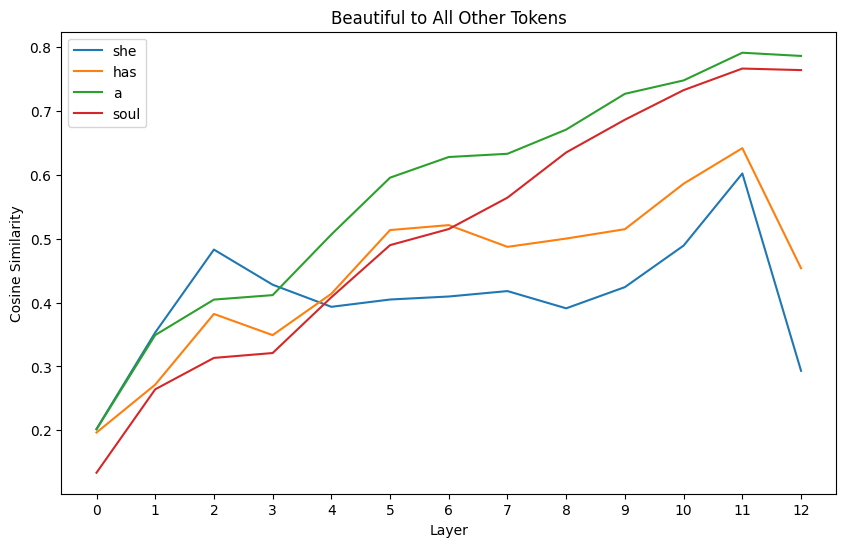

In [79]:
bert_base.view_token_distance_across_layers('She has a beautiful soul', 'beautiful')

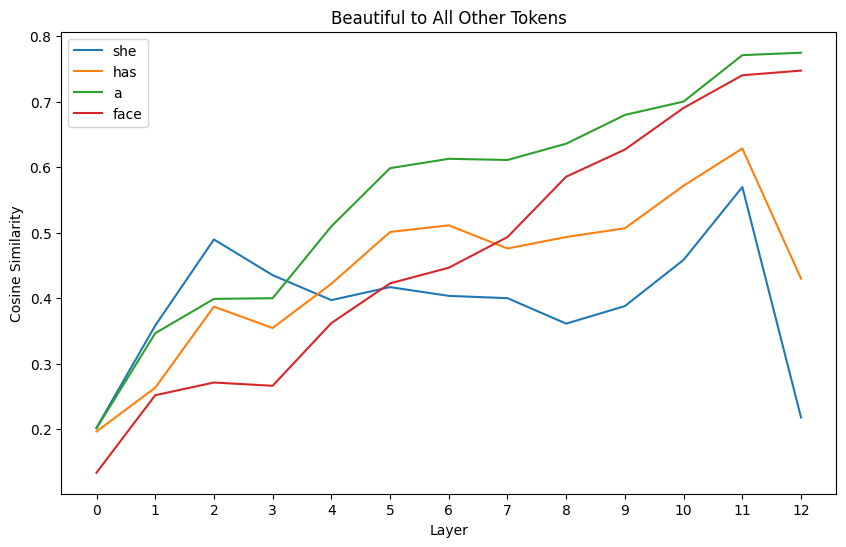

In [80]:
bert_base.view_token_distance_across_layers('She has a beautiful face', 'beautiful')

In [9]:
abs = 'She has a beautiful soul.'
spec = 'She has a beautiful face.'

token = 'beautiful'

abs_token = 'soul'
spec_token = 'face'

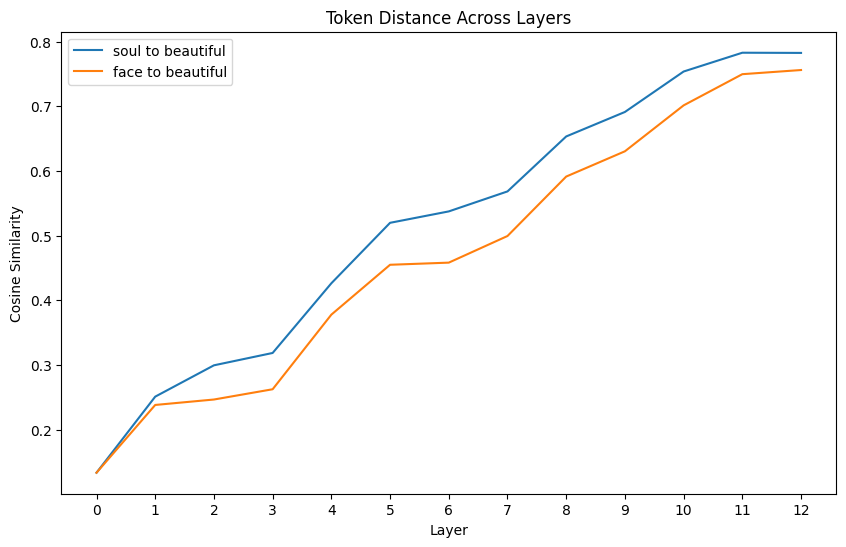

In [29]:
bert_base.view_token_distance(token, abs, abs_token, spec, spec_token)

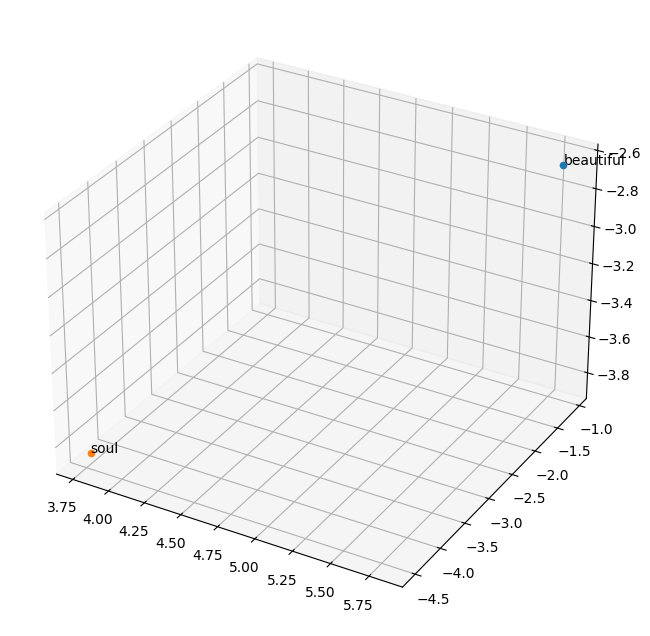

In [129]:
bert_base.embedding_distance_view(abs, token, abs_token)

In [ ]:
bert_base.embedding_distance_view(abs, token, spec_token)

In [175]:
bert_base.embedding_view("She has a beautiful face and soul.", interactive=True, n_layer=5)

In [10]:
world = SPECIFIC_ABSTRACT_DATA.iloc[1]
bert_base.head_view(world.specific, world.abstract)

<IPython.core.display.Javascript object>

In [14]:
bert_base.are_related(world.specific, world.abstract)

tensor(False)

In [11]:
bert_base.neuron_view(world.specific, world.abstract)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
beautiful = SPECIFIC_ABSTRACT_DATA.iloc[0]
msft_l6.head_view(beautiful.specific, beautiful.abstract)

In [ ]:
school = SPECIFIC_ABSTRACT_DATA.iloc[2]
msft_l6.head_view(school.specific, school.abstract)

In [46]:
specific_abstract_prompt = "She has a beautiful face and a beautiful soul."
bert_base.choose(specific_abstract_prompt, choices)

,choice,probability
2,good person,0.268713
1,ugly,0.244708
0,bad person,0.244262
3,gorgeous,0.242317


In [81]:
bert_large = TF(model_name=MODEL_BERT_LARGE)

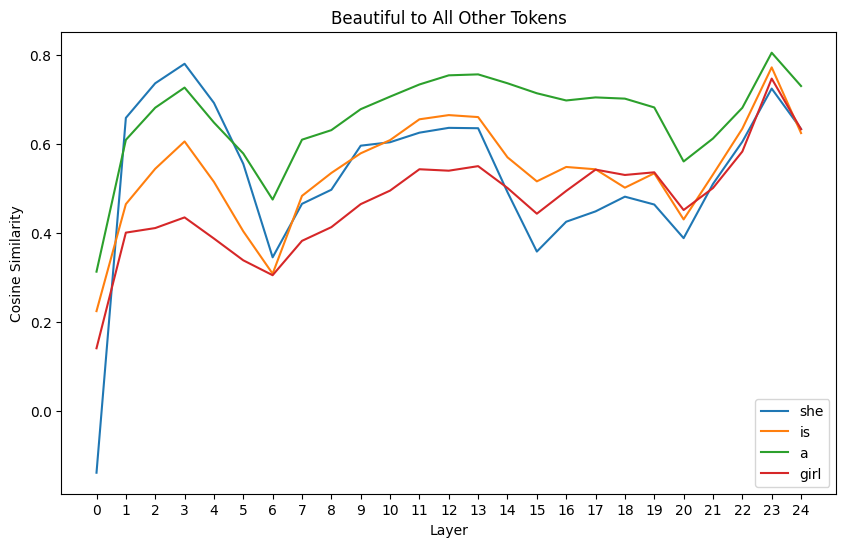

In [85]:
bert_large.view_token_distance_across_layers('She is a beautiful girl', 'beautiful')

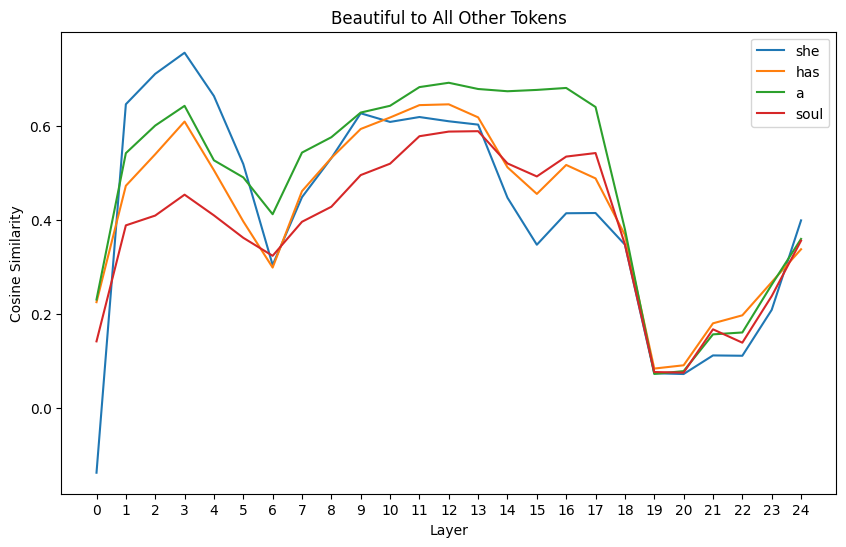

In [88]:
bert_large.view_token_distance_across_layers('She has a beautiful soul', 'beautiful')

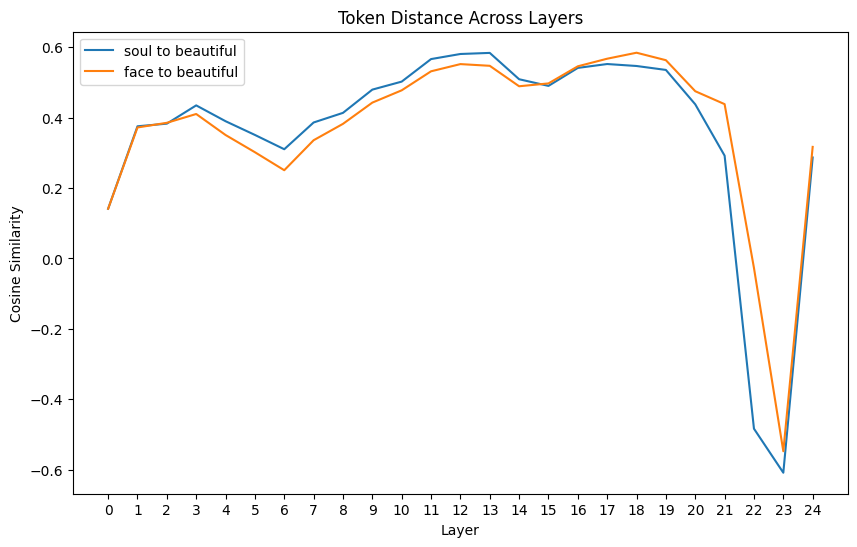

In [14]:
bert_large.view_token_distance(token, abs, abs_token, spec, spec_token)

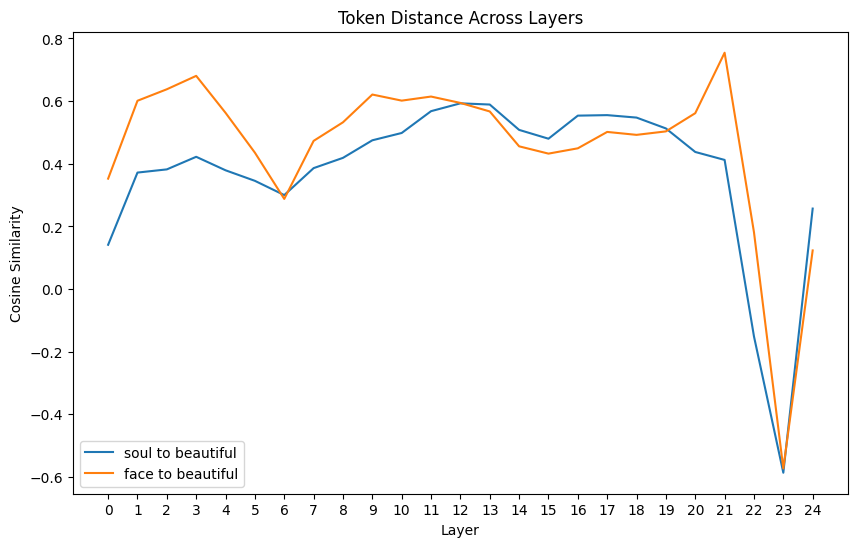

In [38]:
s= 'She has a beautiful soul and face.'
w = 'beautiful'
a = 'soul'
b = 'face'
bert_large.view_token_distance(w,s, a, s, b)

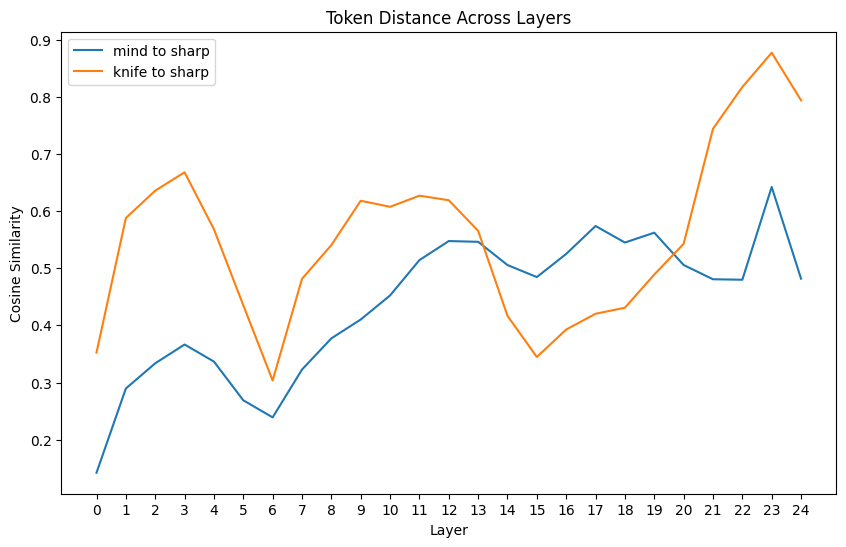

In [16]:
s = 'She has a sharp mind and knife.'
w = 'sharp'
a = 'mind'
b = 'knife'
bert_large.view_token_distance(w,s, a, s, b)

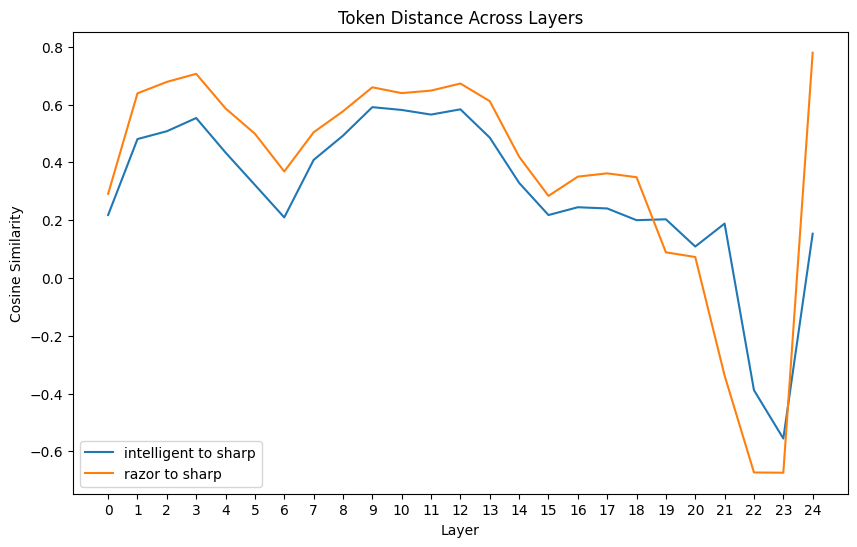

In [17]:
s = 'she has a sharp mind and knife. razor or intelligent'
w = 'sharp'
a = 'intelligent'
b = 'razor'
bert_large.view_token_distance(w,s, a, s, b)

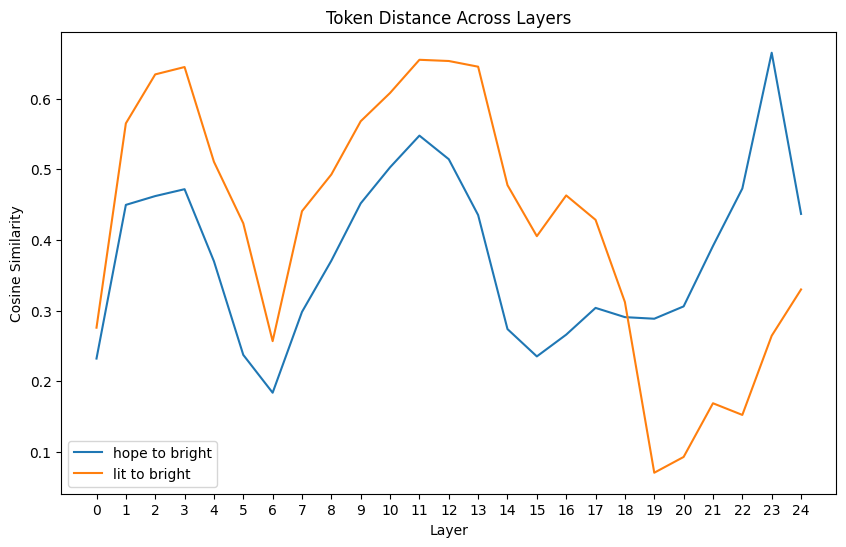

In [30]:
s = 'the room is bright like her future. lit or hope'
w = 'bright'
a = 'lit'
b = 'hope'
bert_large.view_token_distance(w,s, b, s, a)

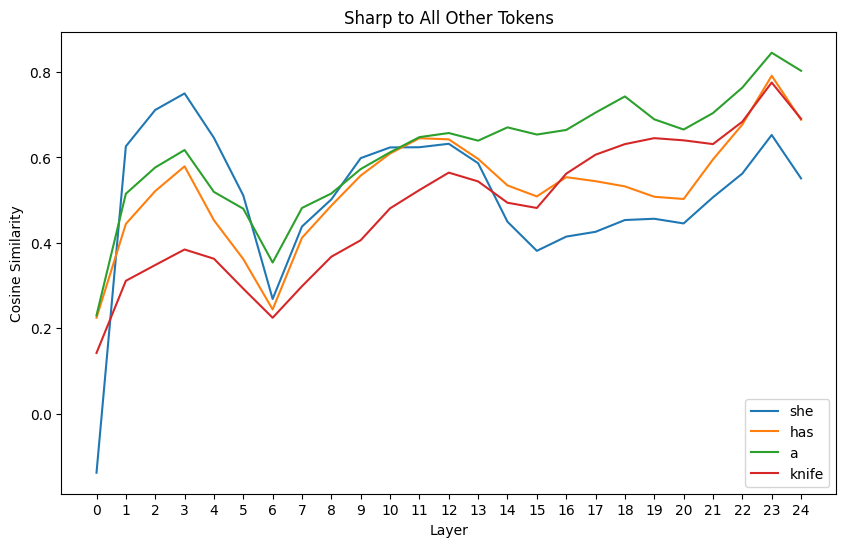

In [89]:
bert_large.view_token_distance_across_layers('She has a sharp knife.', 'sharp')

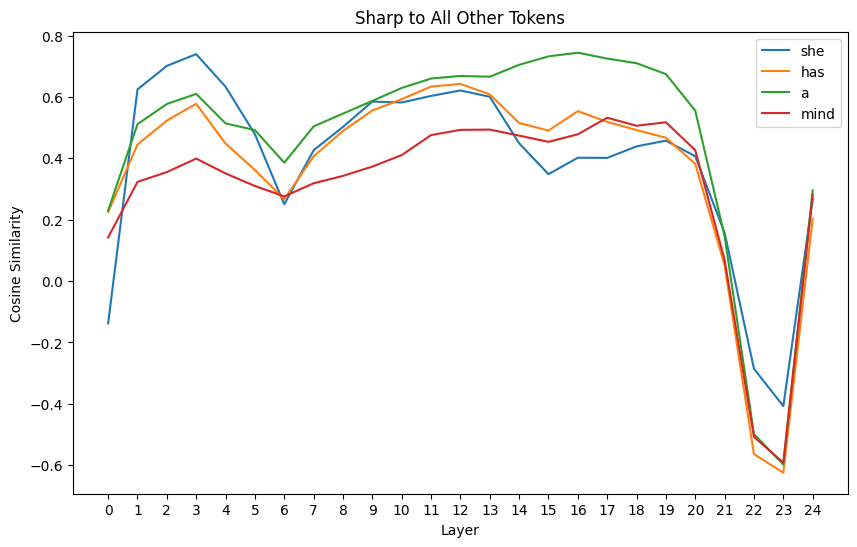

In [90]:
bert_large.view_token_distance_across_layers('She has a sharp mind.', 'sharp')

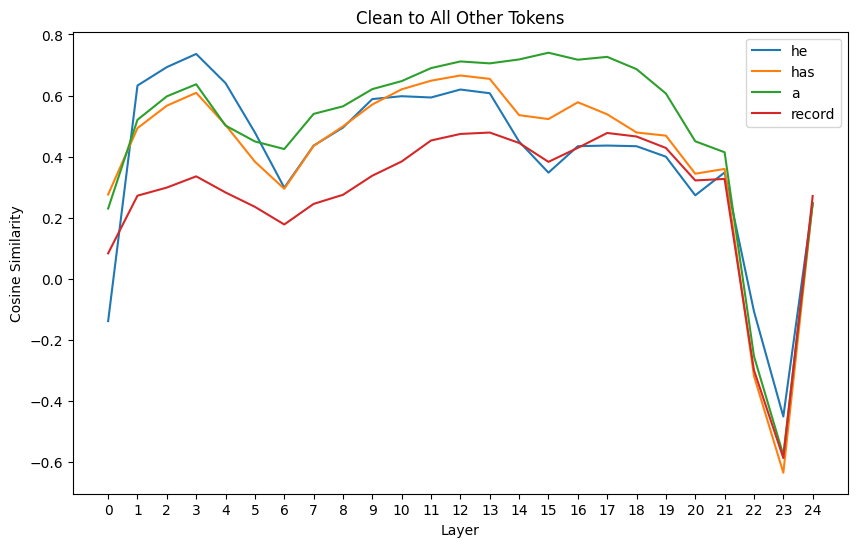

In [91]:
bert_large.view_token_distance_across_layers('he has a clean record.', 'clean')

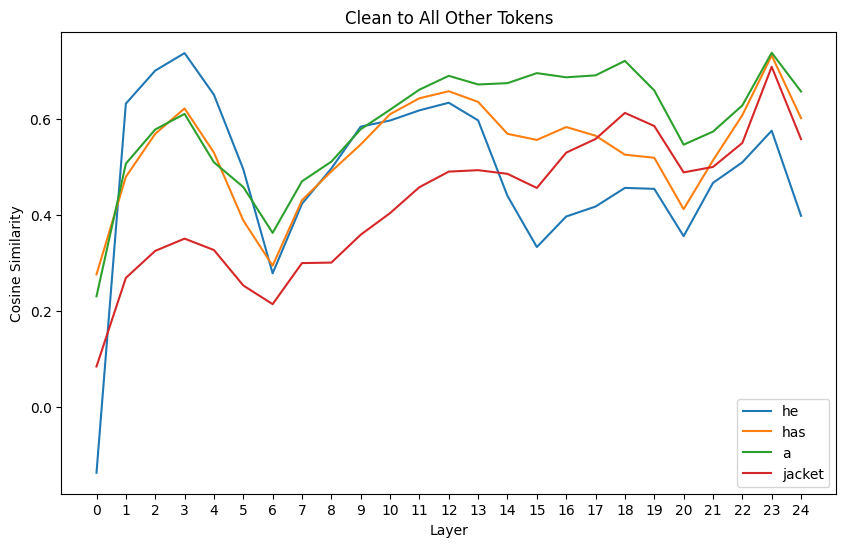

In [92]:
bert_large.view_token_distance_across_layers('he has a clean jacket.', 'clean')

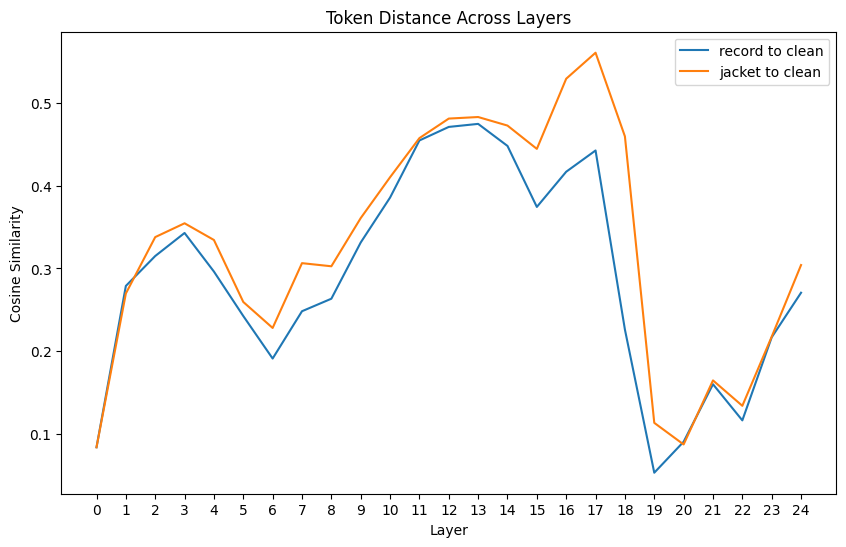

In [35]:
a = 'he has a clean record'
s = 'he has a clean jacket'
w = 'clean'
aw = 'record'
sw = 'jacket'

bert_large.view_token_distance(w,a, aw, s, sw)

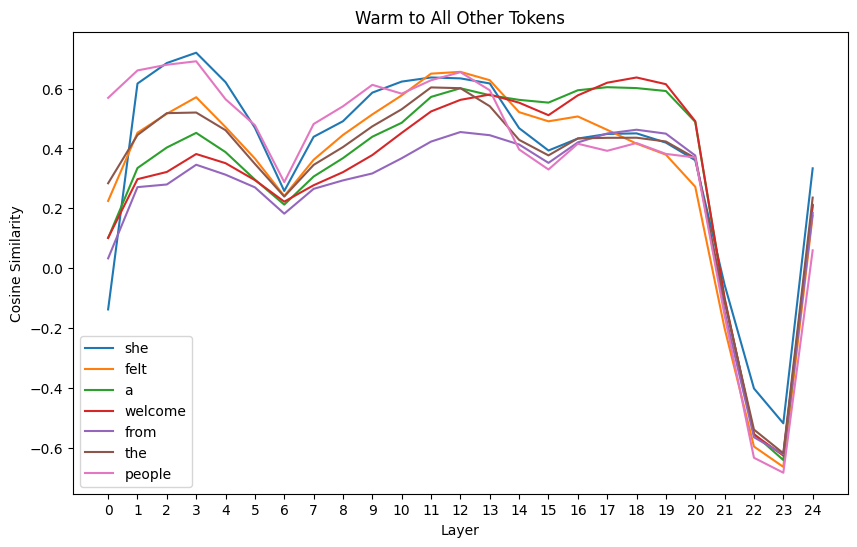

In [136]:
bert_large.view_token_distance_across_layers('She felt a warm welcome from the people.', 'warm')

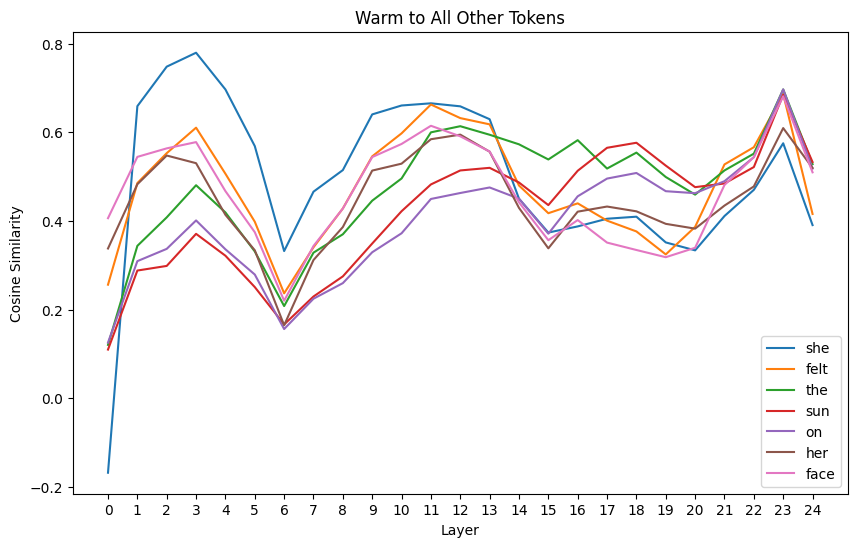

In [138]:
bert_large.view_token_distance_across_layers('She felt the warm sun on her face.', 'warm')

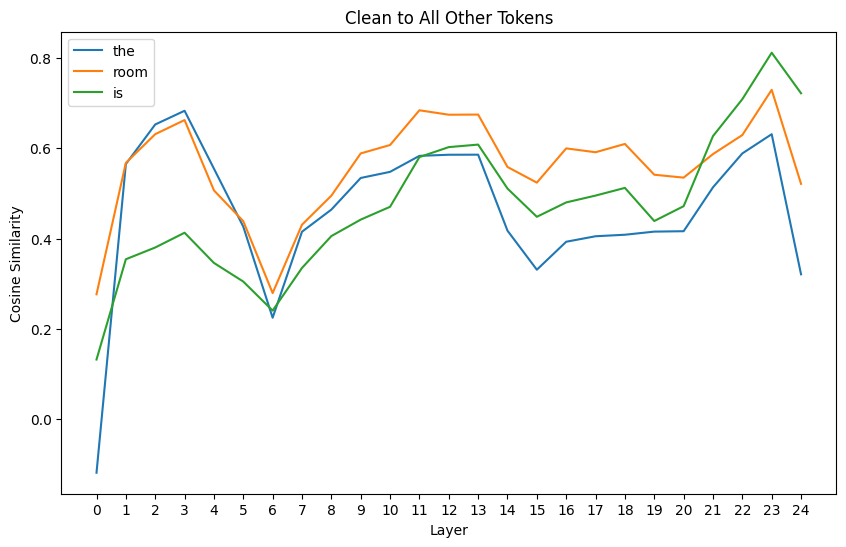

In [97]:
bert_large.view_token_distance_across_layers('The room is clean.', 'clean')

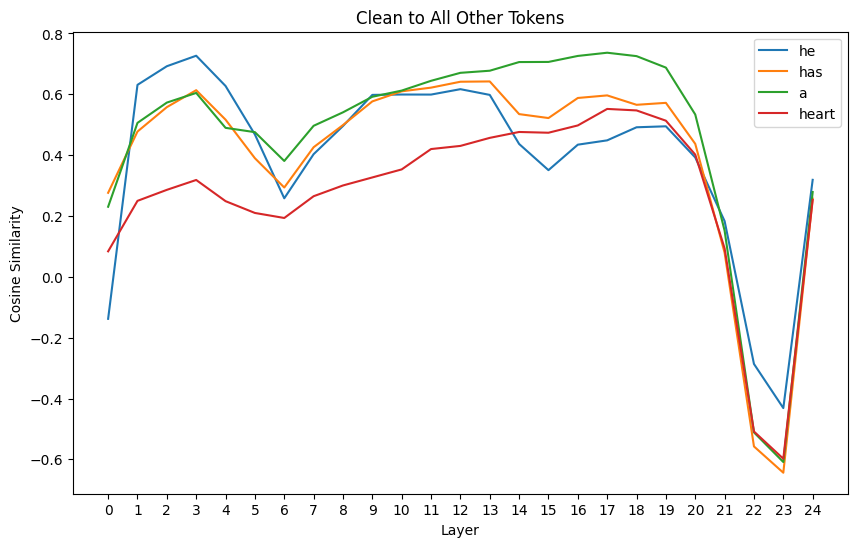

In [99]:
bert_large.view_token_distance_across_layers('He has a clean heart.', 'clean')

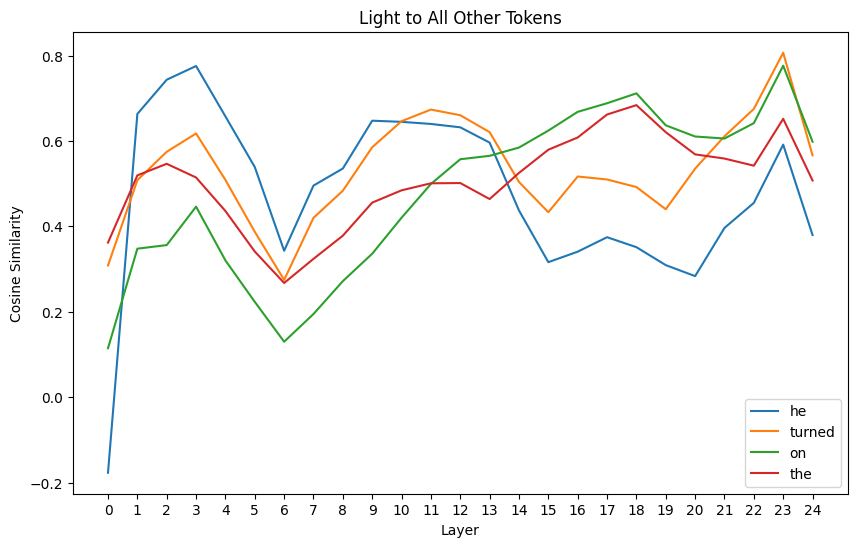

In [103]:
bert_large.view_token_distance_across_layers('He turned on the light.', 'light')

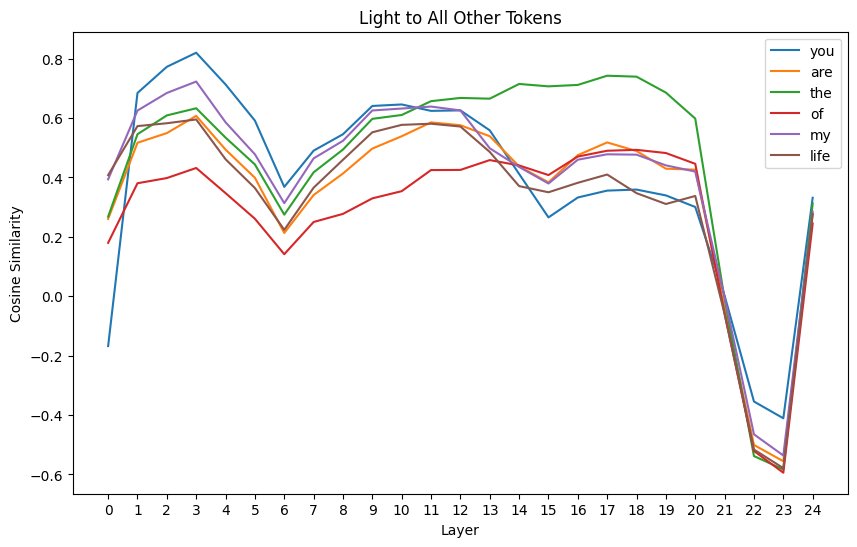

In [104]:
bert_large.view_token_distance_across_layers('You are the light of my life.', 'light')

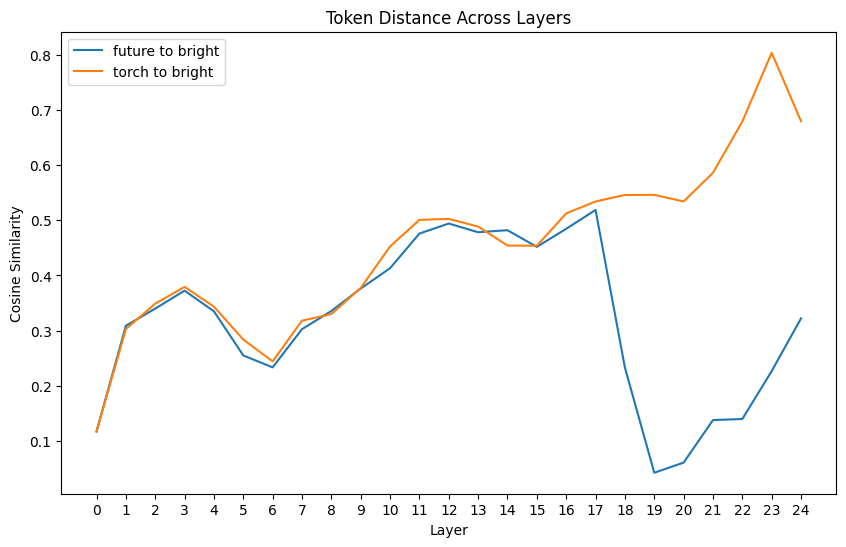

In [32]:
a = 'she has a bright future'
s = 'she has a bright torch'
w = 'bright'
aw = 'future'
sw = 'torch'
bert_large.view_token_distance(w,a, aw, s, sw)

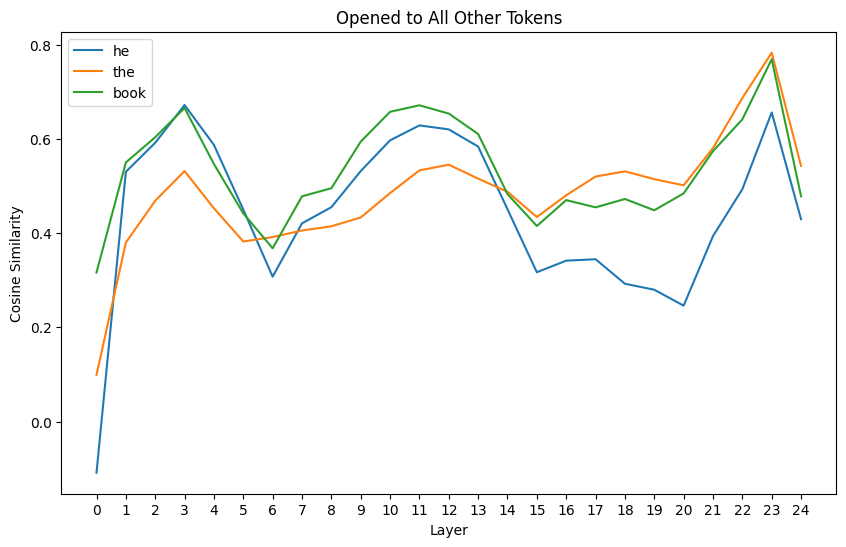

In [110]:
bert_large.view_token_distance_across_layers('He opened the book.', 'opened')

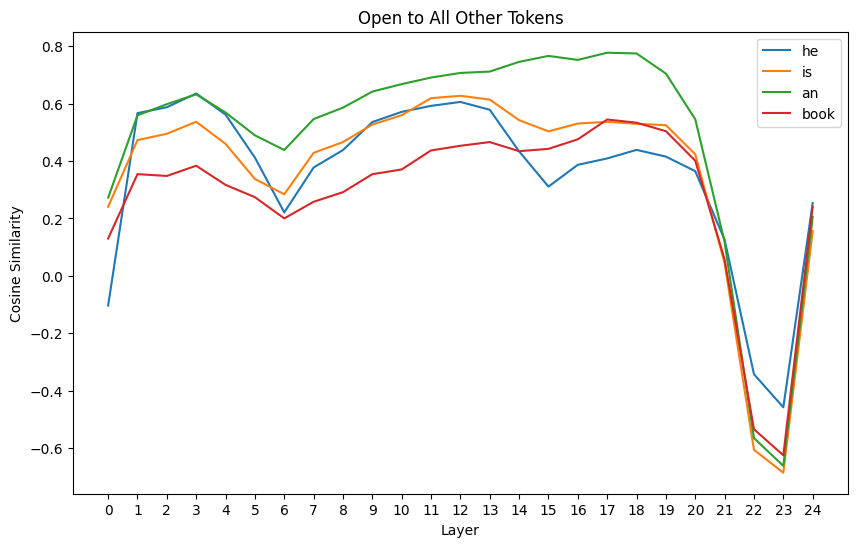

In [109]:
bert_large.view_token_distance_across_layers('He is an open book.', 'open')

In [128]:
choice = [
    'difficult',
    'weight'
]

print('Abstract\n',bert_large.choose('The news is heavy to bear.', choice))
print('Specific\n',bert_large.choose('The box is heavy to lift.', choice))


Abstract
       choice  probability
1     weight     0.535506
0  difficult     0.464494
Specific
       choice  probability
1     weight     0.576621
0  difficult     0.423379


In [ ]:
choice = [
    'difficult',
    'weight'
]

bert_large.choose('She has a heavy burden.', choice)

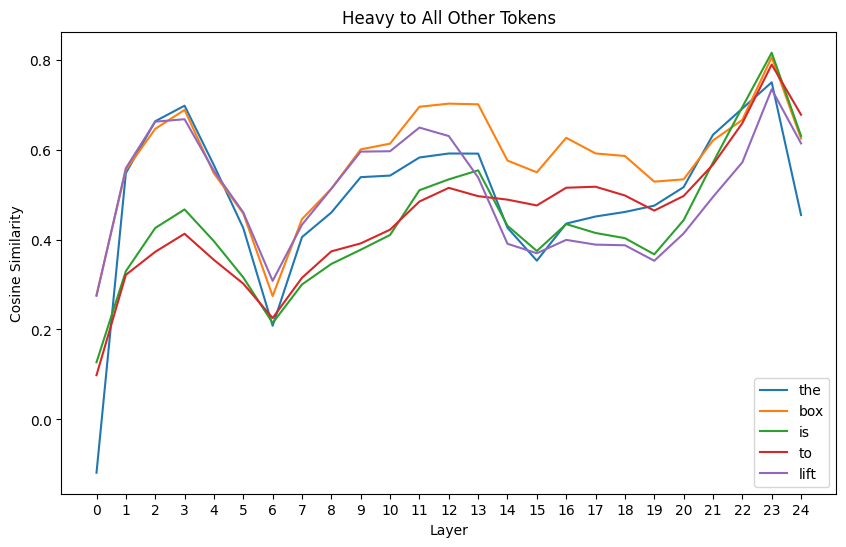

In [126]:
bert_large.view_token_distance_across_layers('The box is heavy to lift.', 'heavy')

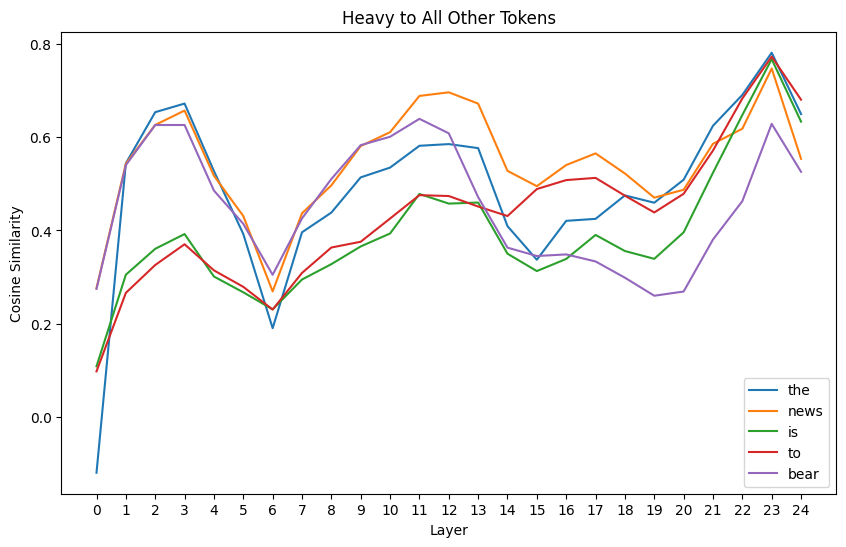

In [127]:
bert_large.view_token_distance_across_layers('The news is heavy to bear.', 'heavy')

In [139]:
choice = [
    'unfriendly',
    'freezing'
]

print('Abstract\n',bert_large.choose('He gave me a cold stare.', choice))
print('Specific\n',bert_large.choose('He gave me a cold water.', choice))

Abstract
        choice  probability
1    freezing     0.533688
0  unfriendly     0.466312
Specific
        choice  probability
0  unfriendly     0.662533
1    freezing     0.337467


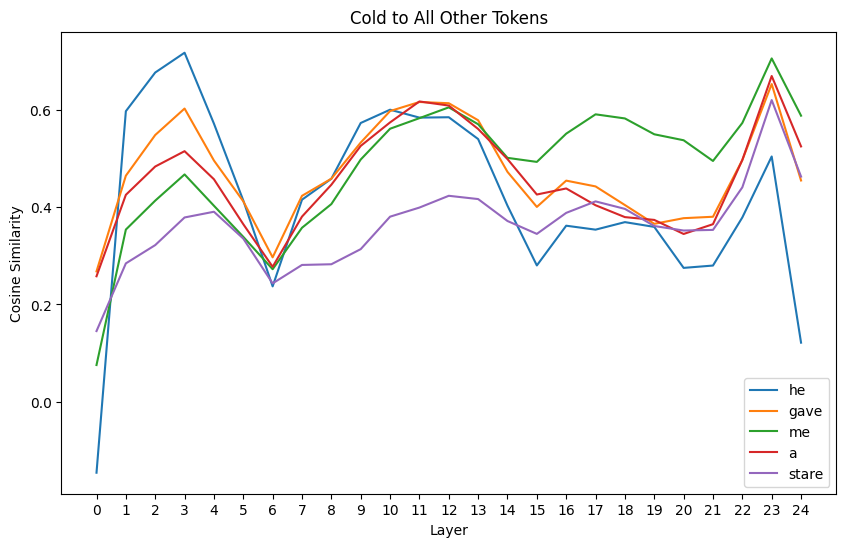

In [140]:
bert_large.view_token_distance_across_layers('He gave me a cold stare.', 'cold')

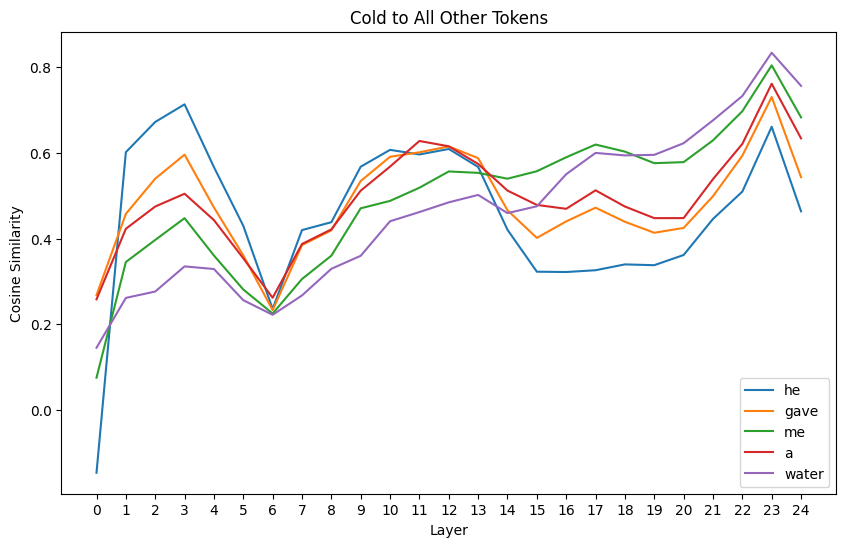

In [141]:
bert_large.view_token_distance_across_layers('He gave me a cold water.', 'cold')

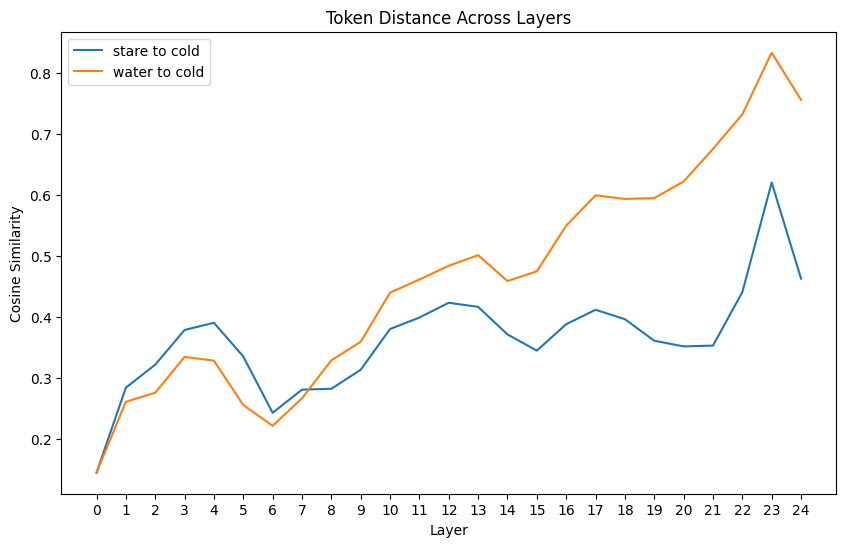

In [33]:
a = 'he gave me a cold stare.'
s = 'he gave me a cold water.'
w = 'cold'
aw = 'stare'
sw = 'water'
bert_large.view_token_distance(w,a, aw, s, sw)

In [153]:
choice = [
    'solid',
    'diligent'
]

print('Abstract\n',bert_large.choose('The employee is hard worker.', choice))
print('Specific\n',bert_large.choose('The rock is hard.', choice))

Abstract
      choice  probability
0     solid     0.505232
1  diligent     0.494768
Specific
      choice  probability
1  diligent     0.645614
0     solid     0.354386


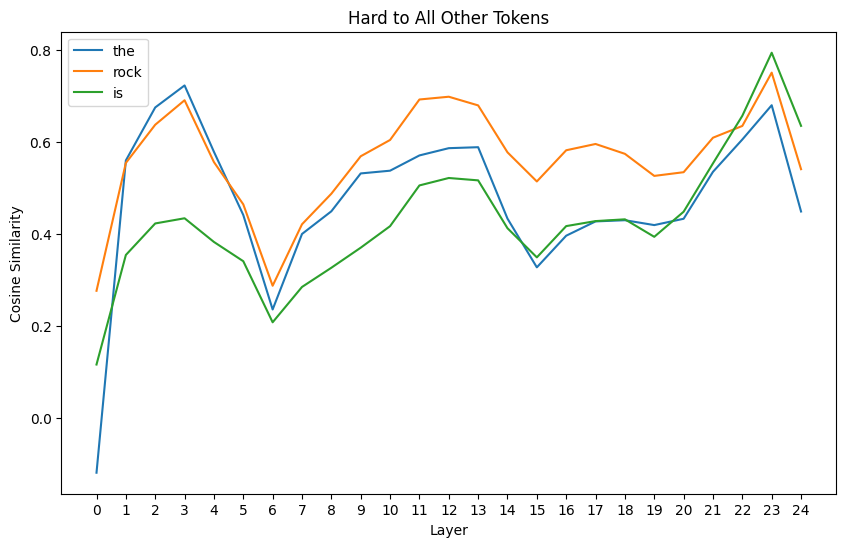

In [147]:
bert_large.view_token_distance_across_layers('The rock is hard.', 'hard')

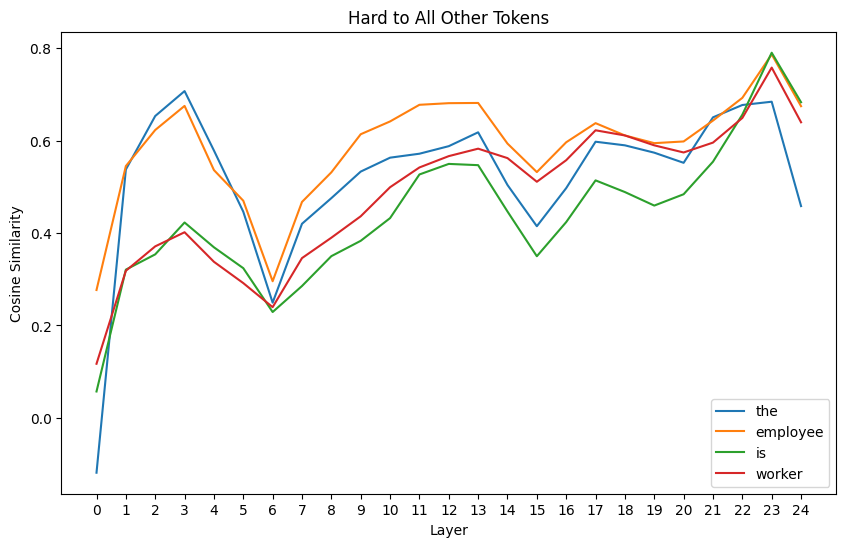

In [154]:
bert_large.view_token_distance_across_layers('The employee is hard worker.', 'hard')

In [207]:
specific_results = [bert_large.choose(question['specific'], question['options']) for question in SEMANTIC_DATA_QUESTIONER]
pd.concat(specific_results)

,choice,probability
0,cutting edge,0.500730
1,intelligent,0.499270
0,illumination,0.501871
1,joy,0.498129
0,Lock device,0.519641
1,Means to success,0.480359
0,low temprature,0.575967
1,unfriendly look,0.424033
0,solid,0.501486
1,diligent worker,0.498514


In [160]:
choice = [
    'plush',
    'calm'
]

print('Abstract\n',bert_large.choose('The music is soft.', choice))
print('Specific\n',bert_large.choose('The pillow is soft.', choice))

Abstract
   choice  probability
0  plush     0.674443
1   calm     0.325557
Specific
   choice  probability
0  plush     0.629583
1   calm     0.370417


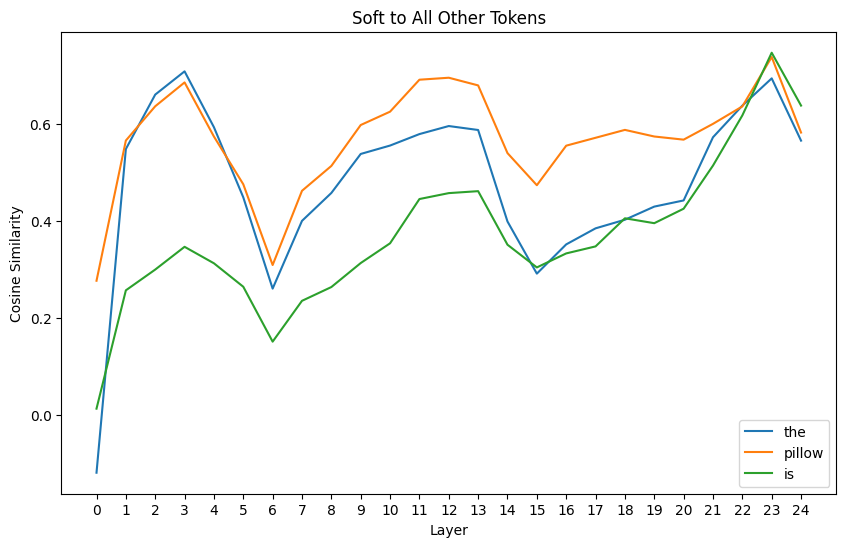

In [162]:
bert_large.view_token_distance_across_layers('The pillow is soft.', 'soft')

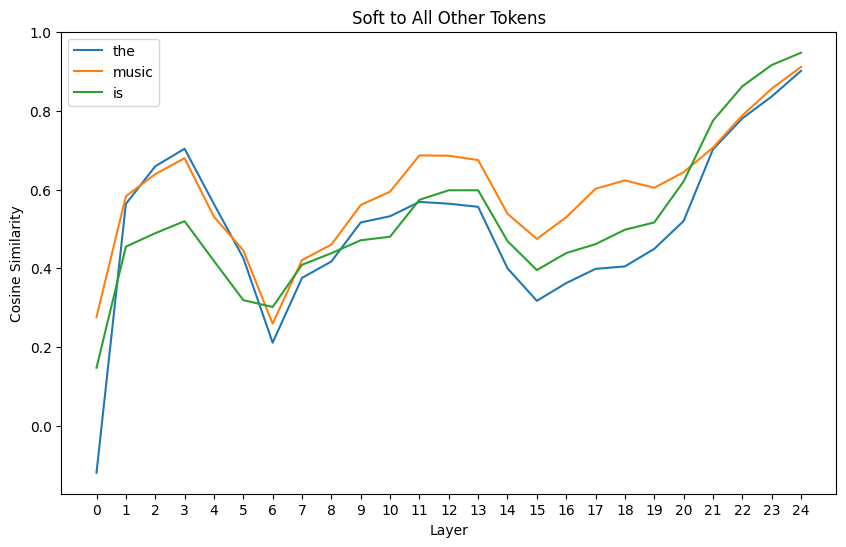

In [161]:
bert_large.view_token_distance_across_layers('The music is soft.', 'soft')

In [214]:
abstract_results = [bert_large.choose(question['abstract'], question['options']) for question in SEMANTIC_DATA_QUESTIONER]
pd.concat(abstract_results)

,choice,probability
1,intelligent,0.521128
0,cutting edge,0.478872
1,joy,0.563585
0,illumination,0.436415
1,Means to success,0.530920
0,Lock device,0.469080
0,low temprature,0.609189
1,unfriendly look,0.390811
0,solid,0.572876
1,diligent worker,0.427124


In [215]:
bert_large.head_view(SEMANTIC_DATA_QUESTIONER[11]['abstract'],SEMANTIC_DATA_QUESTIONER[11]['specific'])

<IPython.core.display.Javascript object>

In [216]:
bert_large.head_view(SEMANTIC_DATA_QUESTIONER[10]['abstract'],SEMANTIC_DATA_QUESTIONER[10]['specific'])

<IPython.core.display.Javascript object>

In [217]:
bert_large.model_view(SEMANTIC_DATA_QUESTIONER[10]['abstract'],SEMANTIC_DATA_QUESTIONER[10]['specific'])

<IPython.core.display.Javascript object>